In [1]:
from PIL import Image
from torchvision import transforms
import matplotlib.pyplot as plt
import time
import numpy as np
import skimage
from skimage import exposure
from dataset.transform import *
from dataset.utils import *
from utils import *
import face_recognition
import pickle
from matplotlib import gridspec
import cv2


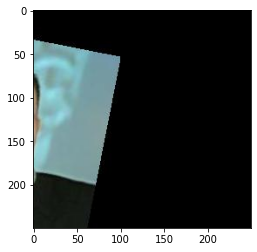

In [21]:

plt.imshow(transforms.functional.affine(ToPILImage()(transforms.ToTensor()(image_file)),angle=0,scale=1,translate=(-50,-0),shear=0))

	Tile 1/1


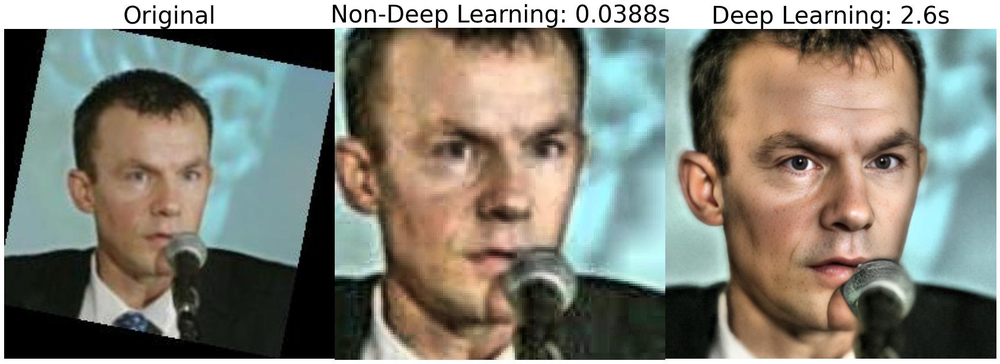

In [10]:
dataset = make_dataset('LFW', face_detection=False, split='10fold', image_size=100)
index = np.random.randint(len(dataset))
image_file = Image.open(dataset.data[index]).convert('RGB')

then=time.time()
enhanced_img = HistogramEqualization()(FaceDetectionCrop(pad_ratio=1.6)(image_file))
enhanced_time=time.time()-then

then=time.time()
restored_img=HistogramEqualization()(FaceDetectionCrop(pad_ratio=1.6)(GFPGANRestorer(bg_upsampler=None)(image_file)))
restore_time=time.time()-then

# Apply filters
filtered_images = [
    image_file,
    enhanced_img,
    restored_img
]

titles = [
    'Original',
    f'Non-Deep Learning: {enhanced_time:.3}s',
    f'Deep Learning: {restore_time:.3}s'
]

# Create subplots using gridspec
fig = plt.figure(figsize=(30, 10.5))
gs = gridspec.GridSpec(1, 3, height_ratios=[1])
gs.update(wspace=0, hspace=0)

# Display images
for i in range(len(filtered_images)):
    ax = plt.subplot(gs[i])
    ax.set_axis_off()
    try: ax.imshow(filtered_images[i])
    except: continue
    try: ax.set_title(titles[i], fontsize=40)
    except: pass

plt.show()

Files already downloaded and verified


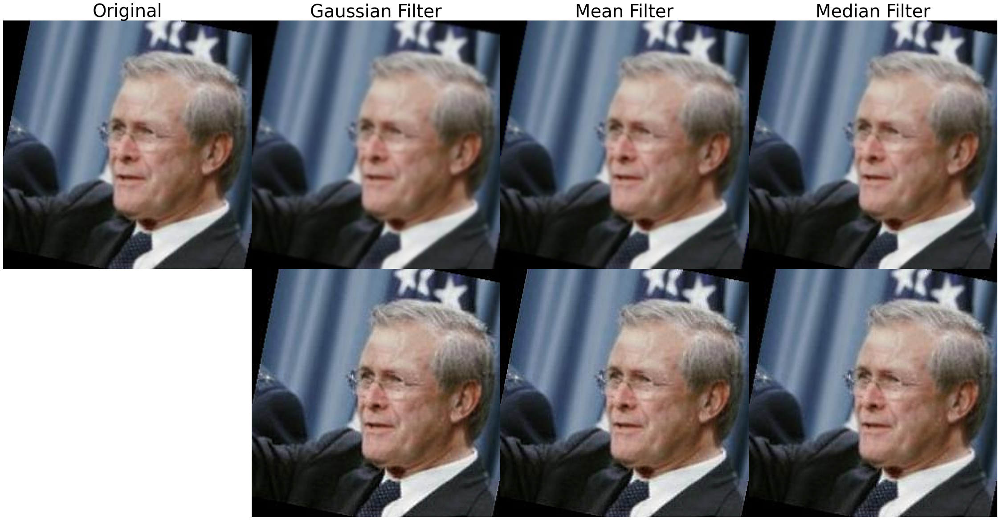

In [59]:
dataset = make_dataset('LFW', face_detection=False, split='10fold', image_size=100)
index = np.random.randint(len(dataset))
image_file = Image.open(dataset.data[index]).convert('RGB')

# Apply filters
filtered_images = [
    image_file,
    GaussianFilter()(image_file),
    MeanFilter()(image_file),
    MedianFilter()(image_file),
    None,
    UnsharpFilter()(image_file),
    MeanUnsharpFilter()(image_file),
    MedianUnsharpFilter()(image_file)
]

titles = [
    'Original',
    'Gaussian Filter',
    'Mean Filter',
    'Median Filter',
]

# Create subplots using gridspec
fig = plt.figure(figsize=(40, 20.5))
gs = gridspec.GridSpec(2, 4, height_ratios=[1, 1])
gs.update(wspace=0, hspace=0)

# Display images
for i in range(len(filtered_images)):
    ax = plt.subplot(gs[i])
    ax.set_axis_off()
    try: ax.imshow(filtered_images[i])
    except: continue
    try: ax.set_title(titles[i], fontsize=40)
    except: pass

plt.show()


Files already downloaded and verified


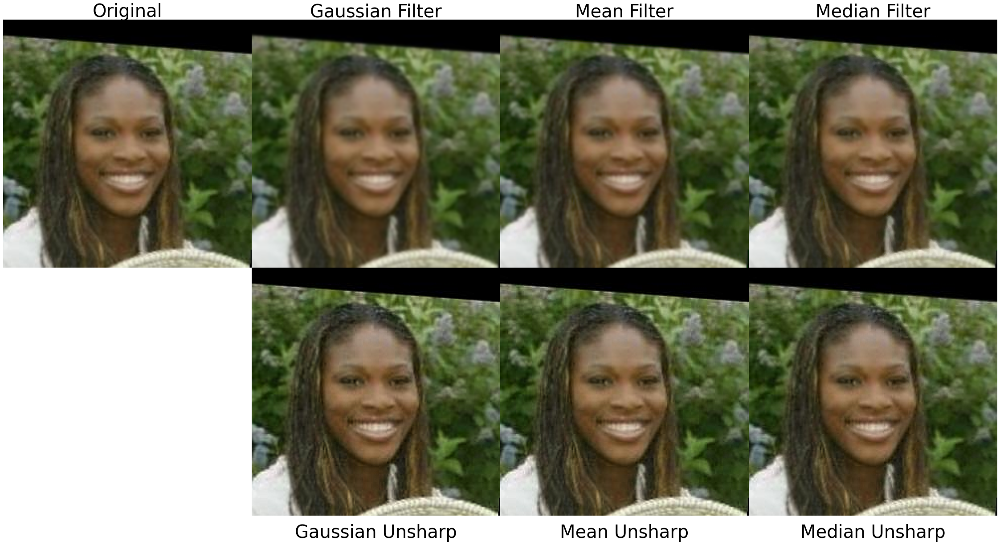

In [72]:
dataset = make_dataset('LFW', face_detection=False, split='10fold', image_size=100)
index = np.random.randint(len(dataset))
image_file = Image.open(dataset.data[index]).convert('RGB')

# Apply filters
filtered_images = [
    image_file,
    GaussianFilter()(image_file),
    MeanFilter()(image_file),
    MedianFilter()(image_file),
    None,
    UnsharpFilter()(image_file),
    MeanUnsharpFilter()(image_file),
    MedianUnsharpFilter()(image_file)
]

titles = [
    'Original',
    'Gaussian Filter',
    'Mean Filter',
    'Median Filter',
    '',
    'Gaussian Unsharp',
    'Mean Unsharp',
    'Median Unsharp',
]

y=[1]*4+[-.1]*4

# Create subplots using gridspec
fig = plt.figure(figsize=(40, 20.5))
gs = gridspec.GridSpec(2, 4, height_ratios=[1, 1])
gs.update(wspace=0, hspace=0)

# Display images
for i in range(len(filtered_images)):
    ax = plt.subplot(gs[i])
    ax.set_axis_off()
    try: ax.imshow(filtered_images[i])
    except: continue
    try: ax.set_title(titles[i], fontsize=40, y=y[i])
    except: pass

plt.show()


Files already downloaded and verified
Files already downloaded and verified


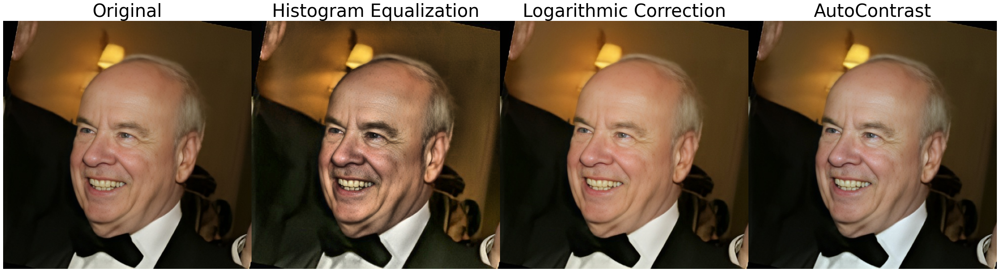

In [160]:
preprocess_dataset({},gfpgan=True)
dataset = make_dataset('LFW', face_detection=False, split='10fold', image_size=100)
index = np.random.randint(len(dataset))
image_file = Image.open(dataset.data[index]).convert('RGB')

# Apply filters
filtered_images = [
    image_file,
    HistogramEqualization(clip_limit=.01)(image_file),
    AdjustLog()(image_file),
    AutoContrast()(image_file)
]

titles = [
    'Original',
    'Histogram Equalization',
    'Logarithmic Correction',
    'AutoContrast',
]

# Create subplots using gridspec
fig = plt.figure(figsize=(40, 10.5))
gs = gridspec.GridSpec(1, 4, height_ratios=[1])
gs.update(wspace=0, hspace=0)

# Display images
for i in range(len(filtered_images)):
    ax = plt.subplot(gs[i])
    ax.set_axis_off()
    try: ax.imshow(filtered_images[i])
    except: continue
    try: ax.set_title(titles[i], fontsize=40)
    except: pass

plt.show()

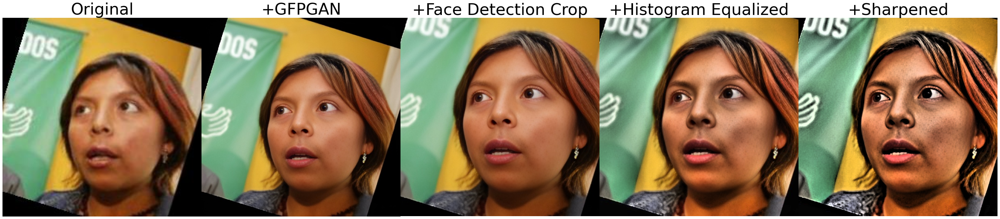

In [173]:
# preprocess_dataset({})
# dataset = make_dataset('LFW', face_detection=False, split='10fold', image_size=100)
# index = np.random.randint(len(dataset))
# image_file = Image.open(dataset.data[index]).convert('RGB')

# preprocess_dataset({},gfpgan=True)
# gfpgan_image_file = Image.open(dataset.data[index]).convert('RGB')
# face_detected_image = FaceDetectionCrop(pad_ratio=1.6)(gfpgan_image_file)
# equalized_image = HistogramEqualization(clip_limit=.01)(face_detected_image)
# sharpened_image = UnsharpFilter(radius=5,amount=1)(equalized_image)

# # Apply filters
# filtered_images = [
#     image_file,
#     gfpgan_image_file,
#     face_detected_image,
#     equalized_image,
#     sharpened_image
# ]

# titles = [
#     'Original',
#     '+GFPGAN',
#     '+Face Detection Crop',
#     '+Histogram Equalized',
#     '+Sharpened'
# ]

# Create subplots using gridspec
n = len(filtered_images)
fig = plt.figure(figsize=(n*10, 10.5))
gs = gridspec.GridSpec(1, n, height_ratios=[1])
gs.update(wspace=0, hspace=0)

# Display images
for i in range(len(filtered_images)):
    ax = plt.subplot(gs[i])
    ax.set_axis_off()
    try: ax.imshow(filtered_images[i])
    except: continue
    try: ax.set_title(titles[i], fontsize=45)
    except: pass

plt.show()

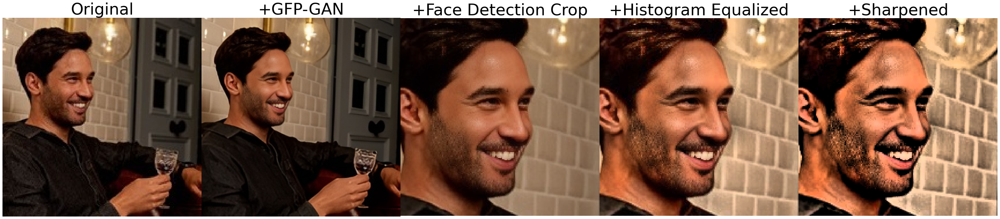

In [180]:
image_file = Image.open('../randomFace-Copy1.jpg').convert('RGB')
gfpgan_image_file = Image.open('../randomFace.jpg').convert('RGB')
face_detected_image = FaceDetectionCrop(pad_ratio=1.6)(gfpgan_image_file)
equalized_image = HistogramEqualization(clip_limit=.01)(face_detected_image)
sharpened_image = UnsharpFilter(radius=5,amount=1)(equalized_image)

# Apply filters
filtered_images = [
    image_file,
    gfpgan_image_file,
    face_detected_image,
    equalized_image,
    sharpened_image
]

titles = [
    'Original',
    '+GFP-GAN',
    '+Face Detection Crop',
    '+Histogram Equalized',
    '+Sharpened'
]

# Create subplots using gridspec
n = len(filtered_images)
fig = plt.figure(figsize=(n*10, 10.5))
gs = gridspec.GridSpec(1, n, height_ratios=[1])
gs.update(wspace=0, hspace=0)

# Display images
for i in range(len(filtered_images)):
    ax = plt.subplot(gs[i])
    ax.set_axis_off()
    try: ax.imshow(filtered_images[i])
    except: continue
    try: ax.set_title(titles[i], fontsize=45)
    except: pass

plt.show()

Files already downloaded and verified
Files already downloaded and verified


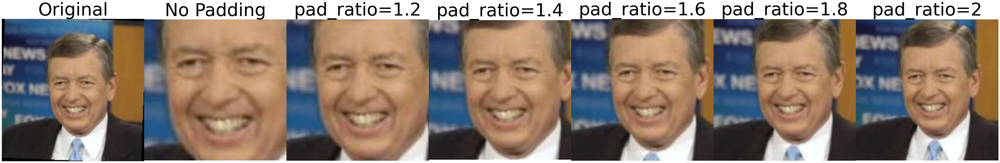

In [170]:
preprocess_dataset({})
dataset = make_dataset('LFW', face_detection=False, split='10fold', image_size=100)
index = np.random.randint(len(dataset))
image_file = Image.open(dataset.data[index]).convert('RGB')

# Apply filters
filtered_images = [
    image_file,
    FaceDetectionCrop(pad_ratio=1)(image_file),
    FaceDetectionCrop(pad_ratio=1.2)(image_file),
    FaceDetectionCrop(pad_ratio=1.4)(image_file),
    FaceDetectionCrop(pad_ratio=1.6)(image_file),
    FaceDetectionCrop(pad_ratio=1.8)(image_file),
    FaceDetectionCrop(pad_ratio=2)(image_file)
]

titles = [
    'Original',
    'No Padding',
    'pad_ratio=1.2',
    'pad_ratio=1.4',
    'pad_ratio=1.6',
    'pad_ratio=1.8',
    'pad_ratio=2',
]

# Create subplots using gridspec
n = len(filtered_images)
fig = plt.figure(figsize=(n*10, 10.5))
gs = gridspec.GridSpec(1, n, height_ratios=[1])
gs.update(wspace=0, hspace=0)

# Display images
for i in range(len(filtered_images)):
    ax = plt.subplot(gs[i])
    ax.set_axis_off()
    try: ax.imshow(filtered_images[i])
    except: continue
    try: ax.set_title(titles[i], fontsize=70)
    except: pass

plt.show()

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified


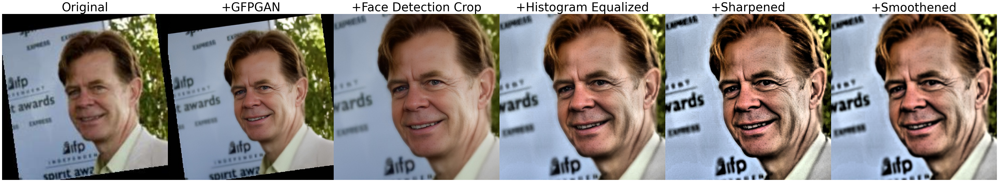

In [165]:
preprocess_dataset({})
dataset = make_dataset('LFW', face_detection=False, split='10fold', image_size=100)
index = np.random.randint(len(dataset))
image_file = Image.open(dataset.data[index]).convert('RGB')

preprocess_dataset({},gfpgan=True)
gfpgan_image_file = Image.open(dataset.data[index]).convert('RGB')
face_detected_image = FaceDetectionCrop(pad_ratio=1.6)(gfpgan_image_file)
equalized_image = HistogramEqualization(clip_limit=.01)(face_detected_image)
sharpened_image = UnsharpFilter(radius=5,amount=1)(equalized_image)
smoothened_image = GaussianFilter(sigma=1)(sharpened_image)

# Apply filters
filtered_images = [
    image_file,
    gfpgan_image_file,
    face_detected_image,
    equalized_image,
    sharpened_image,
    smoothened_image
]

titles = [
    'Original',
    '+GFPGAN',
    '+Face Detection Crop',
    '+Histogram Equalized',
    '+Sharpened',
    '+Smoothened'
]

# Create subplots using gridspec
n = len(filtered_images)
fig = plt.figure(figsize=(n*10, 10.5))
gs = gridspec.GridSpec(1, n, height_ratios=[1])
gs.update(wspace=0, hspace=0)

# Display images
for i in range(len(filtered_images)):
    ax = plt.subplot(gs[i])
    ax.set_axis_off()
    try: ax.imshow(filtered_images[i])
    except: continue
    try: ax.set_title(titles[i], fontsize=40)
    except: pass

plt.show()

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified


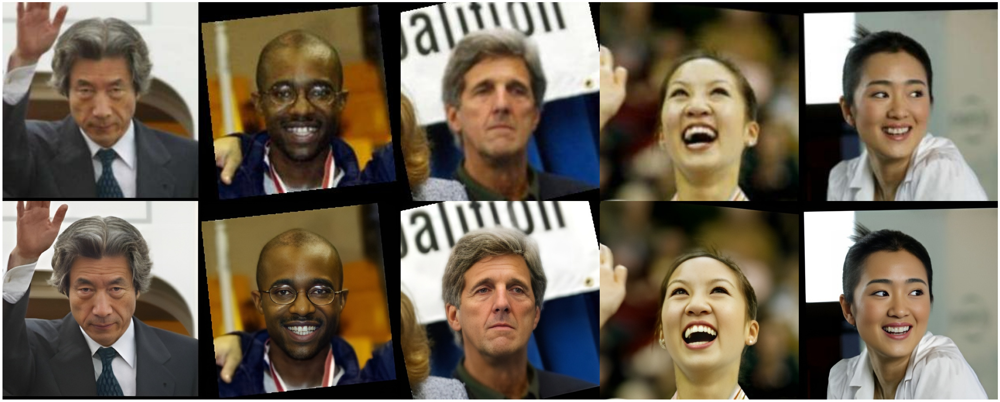

In [153]:
index1 = np.random.randint(len(dataset))
index2 = np.random.randint(len(dataset))
index3 = np.random.randint(len(dataset))
index4 = np.random.randint(len(dataset))
index5 = np.random.randint(len(dataset))
preprocess_dataset({})
random_indexes=[index1,index2,index3,index4,index5]
filtered_images = []
for i in range(5):
    dataset = make_dataset('LFW', face_detection=False, split='10fold', image_size=100)
    image_file = Image.open(dataset.data[random_indexes[i]]).convert('RGB')
    filtered_images += [image_file]
preprocess_dataset({},gfpgan=True)
for i in range(5):
    dataset = make_dataset('LFW', face_detection=False, split='10fold', image_size=100)
    image_file = Image.open(dataset.data[random_indexes[i]]).convert('RGB')
    filtered_images += [image_file]

titles = [
#     'Original',
#     '',
#     '',
#     '',
#     '',
#     '',
#     'GFPGAN'
]

# Create subplots using gridspec
fig = plt.figure(figsize=(50, 20.5))
gs = gridspec.GridSpec(2, 5, height_ratios=[1,1])
gs.update(wspace=0, hspace=0)

# Display images
for i in range(len(filtered_images)):
    ax = plt.subplot(gs[i])
    ax.set_axis_off()
    try: ax.set_title(titles[i], fontsize=60, y=0.5)
    except: pass
    try: ax.imshow(filtered_images[i])
    except: continue

plt.show()


In [13]:
import os
for path in os.listdir('./saved_models'):
    try:
        name = os.path.splitext(path)[0]
        full_path = f'./saved_models/{path}'
        far,tar,thresholds=roc_curve(loaded_data['labels'],loaded_data[f'sim_scores_{name}'])
        tar_far = tar_at_far(tar,far)
        if tar_far == None:
            continue
        save_output(tar_far,f'tar@far_{name}')
        print(name)
    except:
        pass

TAR@FAR:
    1%: 0.5280
  0.1%: 0.2740
 0.01%: 0.1840
0.001%: 0.1840
PA+Unsharp(radius=3, amount=1)
TAR@FAR:
    1%: 0.5660
  0.1%: 0.2680
 0.01%: 0.1100
0.001%: 0.1100
PA+MedianUnsharp(size=3)
TAR@FAR:
    1%: 0.5420
  0.1%: 0.3460
 0.01%: 0.1380
0.001%: 0.1380
PA+MedianUnsharp(size=5)
TAR@FAR:
    1%: 0.5500
  0.1%: 0.2840
 0.01%: 0.1600
0.001%: 0.1600
PA+MedianUnsharp(size=1)
TAR@FAR:
    1%: 0.5200
  0.1%: 0.2400
 0.01%: 0.1260
0.001%: 0.1260
PA+AdjustLog
TAR@FAR:
    1%: 0.5940
  0.1%: 0.3600
 0.01%: 0.2600
0.001%: 0.2600
PA
TAR@FAR:
    1%: 0.5820
  0.1%: 0.3260
 0.01%: 0.1840
0.001%: 0.1840
PA+Adapthist(clip_limit=.01)
TAR@FAR:
    1%: 0.5840
  0.1%: 0.3240
 0.01%: 0.2220
0.001%: 0.2220
PA+Unsharp(radius=5, amount=1)
TAR@FAR:
    1%: 0.5380
  0.1%: 0.3540
 0.01%: 0.2100
0.001%: 0.2100
PA+Unsharp(radius=1, amount=1)
TAR@FAR:
    1%: 0.5360
  0.1%: 0.3600
 0.01%: 0.2360
0.001%: 0.2360
PA+Adapthist(clip_limit=.001)
TAR@FAR:
    1%: 0.5860
  0.1%: 0.2920
 0.01%: 0.1340
0.001%: 0.134

In [12]:
with open('recall.pkl', 'wb') as file:
    pickle.dump(loaded_data, file)

In [126]:
skimage.filters.gaussian(img,preserve_range=True)

array([[1.72626594, 2.01060752, 1.71451769, 1.628134  , 1.84320219,
        1.71270785],
       [1.60513529, 1.80160635, 1.74336063, 1.61604225, 1.68984591,
        1.70482348],
       [1.36329142, 1.45174238, 1.39033328, 1.25291283, 1.37609001,
        1.51955453],
       [1.53745967, 1.73766858, 1.55368449, 1.32010279, 1.60208514,
        1.99532644],
       [1.80761049, 2.25538996, 2.21595018, 1.90543826, 2.04839128,
        2.35364863],
       [1.55808541, 2.14584294, 2.538895  , 2.36558171, 2.07100164,
        1.6789526 ]])

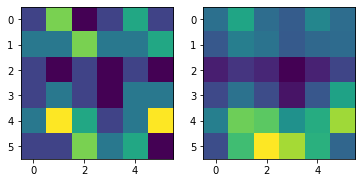

In [125]:
img=np.array([
    [1,4,0,1,3,1],
    [2,2,4,2,2,3],
    [1,0,1,0,1,0],
    [1,2,1,0,2,2],
    [2,5,3,1,2,5],
    [1,1,4,2,3,0]
])
f,ax=plt.subplots(1,2)
ax[0].imshow(img)
ax[1].imshow(skimage.filters.gaussian(img,preserve_range=True))

In [102]:
import numpy as np
import pickle
# Load the data back
with open('recall.pkl', 'rb') as file:
    loaded_data = pickle.load(file)
# loaded_data
import pandas as pd    
data = {
    k:v.item() if type(v).__name__=='Tensor' else v for k, v in loaded_data.items() if
    (
#         'mapr' in k
#         or 'train' in k
#         or 'test' in k
        'tar@far' in k
    )
    and 'GFPGAN' in k
}
df = pd.DataFrame(data)
df.to_csv(r'file.csv')
data

{'tar@far_PA+GFPGAN': (0.608, 0.372, 0.132, 0.132),
 'tar@far_PA+GFPGAN+Adapthist(clip_limit=.01)+Unsharp(radius=5, amount=1)': (0.61,
  0.328,
  0.22,
  0.22),
 'tar@far_PA+GFPGAN+Median(size=1)+MedianUnsharp(size=3)': (0.622,
  0.368,
  0.256,
  0.256),
 'tar@far_PA+GFPGAN+Adapthist(clip_limit=.01)': (0.552, 0.376, 0.252, 0.252)}

In [54]:
import torch
from torch.utils.data import random_split

def split(full_dataset, val_percent, test_percent, random_seed=None):
    amount = len(full_dataset)

    test_amount = (
        int(amount * test_percent)
        if test_percent is not None else 0)
    val_amount = (
        int(amount * val_percent)
        if val_percent is not None else 0)
    train_amount = amount - test_amount - val_amount

    train_dataset, val_dataset, test_dataset = random_split(
        full_dataset,
        (train_amount, val_amount, test_amount),
        generator=(
            torch.Generator().manual_seed(random_seed)
            if random_seed
            else None))
    
    return train_dataset, val_dataset, test_dataset

full_dataset = make_dataset('LFW', split='10fold', image_size=100)
train_dataset, val_dataset, test_dataset = split(full_dataset, 0.0, 0.3, 1)

Files already downloaded and verified


In [23]:
dataset = make_dataset('LFWCustom', face_detection=False,split='train',image_size=100)
# [(c,len(face_recognition.face_locations(np.array(transforms.ToPILImage()(x))))) for c,x in enumerate([y[0] for y in dataset[:1000]]) if len(face_recognition.face_locations(np.array(transforms.ToPILImage()(x))))==0]

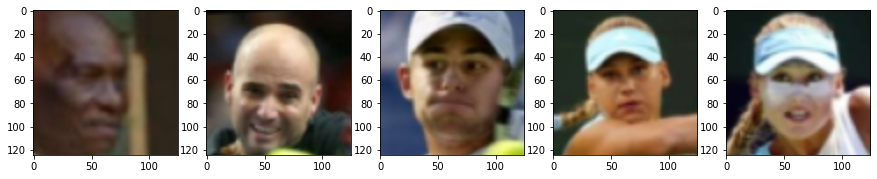

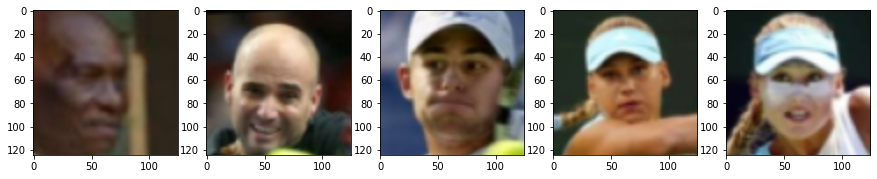

In [35]:
c=0
for i in [4,229,255,293,295]+[4,229,255,293,295]:
    if c==0:
        f, ax = plt.subplots(1,5,figsize=(3*5,3))
    ax[c].imshow(transforms.CenterCrop(125)(transforms.Resize((200,200))(transforms.ToPILImage()(dataset[i][0]))))
#     ax[c].imshow(transforms.CenterCrop(125)(transforms.Resize((200,200))(AutoContrast()(transforms.ToPILImage()(dataset[i][0])))))
    c+=1
    if c==5:
        c=0
        plt.show()
    

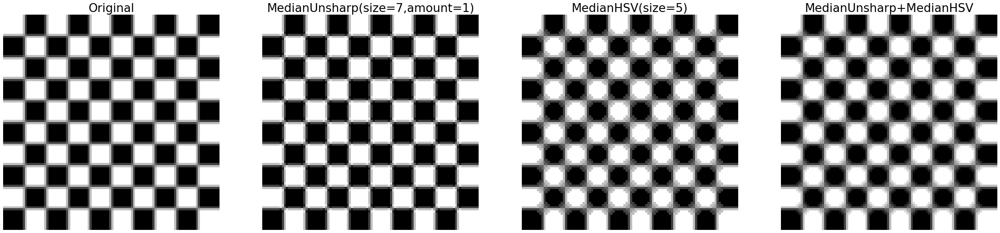

In [123]:
fields = int(10/2)
size = 5
musize,muamount,method,msize=7,1,'sv',5
binary_image = np.kron([[1, 0] * fields, [0, 1] * fields] * fields, np.ones((size, size)))

# Convert the binary image to an RGB image
img = np.stack((binary_image, binary_image, binary_image), axis=-1)
img = transforms.Resize(100)(transforms.ToPILImage()(transforms.ToTensor()(img)))
plt.rcParams.update({'font.size':22})
f,ax=plt.subplots(1,4,figsize=(40,10))
ax[0].imshow(img)
ax[0].set_title('Original')
ax[0].set_axis_off()
filtered_img = MedianUnsharpFilter(size=musize,amount=muamount)(img)
ax[1].imshow(filtered_img)
ax[1].set_title(f'MedianUnsharp(size={musize},amount={muamount})')
ax[1].set_axis_off()

filtered_img = MedianHSVFilter(method=method,size=msize)(img)
ax[2].imshow(filtered_img)
ax[2].set_title(f'MedianHSV(size={msize})')
ax[2].set_axis_off()

filtered_img = MedianHSVFilter(method=method,size=msize)(MedianUnsharpFilter(size=musize,amount=muamount)(img))
ax[3].imshow(filtered_img)
ax[3].set_title(f'MedianUnsharp+MedianHSV')
ax[3].set_axis_off()
plt.show()

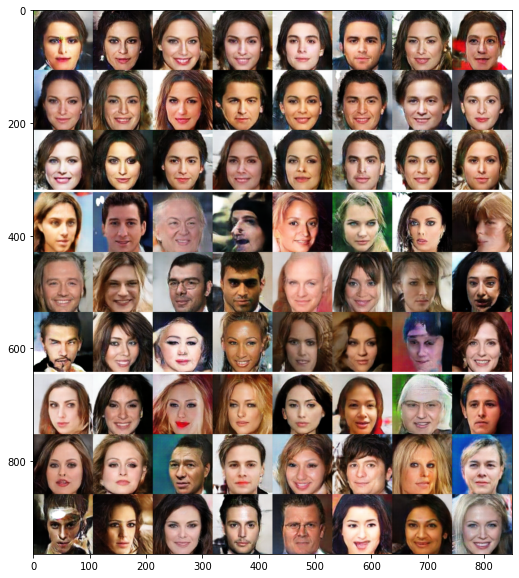

In [68]:
image_file = Image.open(f'./CelebA-Example-8x9.png').convert('RGB')
f, ax = plt.subplots(figsize=(10,10))
ax.imshow(image_file)

time: 0.4235846996307373


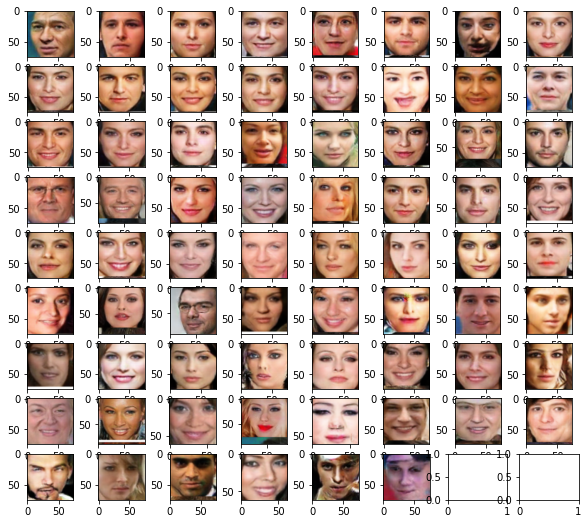

In [82]:
image_file = transforms.Resize((1000,1000))(Image.open(f'./CelebA-Example-8x9.png').convert('RGB'))
then=time.time()
face_locations = face_recognition.face_locations(np.array(image_file))
print(f'time: {time.time()-then}')
# f, ax = plt.subplots(8+1,(len(face_locations)+1)//8, figsize=(10, (len(face_locations)+1)//8))
f, ax = plt.subplots(8+1,8, figsize=(10, 9))
c=0
i=0
for (U,R,D,L) in face_locations:
#     if i == (len(face_locations)+1)//8:
    if i == 8:
        c+=1
        i=0
    ax[c,i].imshow(image_file.crop([L,U,R,D]))
    i+=1
f.show()

time: 0.07161784172058105


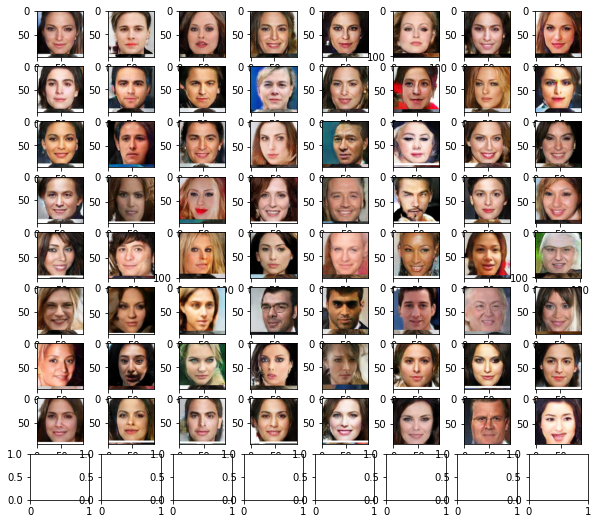

In [26]:
img = cv2.imread('./CelebA-Example-8x9.png')
face_classifier = cv2.CascadeClassifier(
    cv2.data.haarcascades + "haarcascade_frontalface_default.xml"
)
then=time.time()
face_locations = face_classifier.detectMultiScale(
    img, scaleFactor=1.1, minNeighbors=5, minSize=(90, 90)
)
print(f'time: {time.time()-then}')
# f, ax = plt.subplots(8+1,(len(face_locations)+1)//8, figsize=(10, (len(face_locations)+1)//8))
f, ax = plt.subplots(9,8, figsize=(10, 9))
c=0
i=0
for (x,y,w,h) in face_locations:
    L,U,R,D=x,y,x+w,y+h
#     if i == (len(face_locations)+1)//8:
    if i == 8:
        c+=1
        i=0
    ax[c,i].imshow(Image.fromarray(img[:,:,::-1]).crop([L,U,R,D]))
    i+=1
f.show()

